**15장 – RNN과 CNN을 사용해 시퀀스 처리하기**

_이 노트북에는 15장의 모든 샘플 코드와 연습 문제에 대한 해답이 포함되어 있습니다._

<table align="left">
  <td>
    <a href="https://colab.research.google.com/github/rickiepark/handson-ml3/blob/main/15_processing_sequences_using_rnns_and_cnns.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>
  </td>
</table>

# 설정

이 프로젝트에는 Python 3.7 이상이 필요합니다:

In [1]:
import sys

assert sys.version_info >= (3, 7)

그리고 TensorFlow ≥ 2.8:

In [2]:
from packaging import version
import tensorflow as tf

assert version.parse(tf.__version__) >= version.parse("2.8.0")

이전 챕터에서 했던 것처럼 기본 글꼴 크기를 정의하여 그림을 더 예쁘게 만들어 보겠습니다:

In [3]:
import matplotlib.pyplot as plt

plt.rc('font', size=14)
plt.rc('axes', labelsize=14, titlesize=14)
plt.rc('legend', fontsize=14)
plt.rc('xtick', labelsize=10)
plt.rc('ytick', labelsize=10)

import sys
# 코랩의 경우 나눔 폰트를 설치합니다.
if 'google.colab' in sys.modules:
    !sudo apt-get -qq -y install fonts-nanum
    import matplotlib.font_manager as fm
    font_files = fm.findSystemFonts(fontpaths=['/usr/share/fonts/truetype/nanum'])
    for fpath in font_files:
        fm.fontManager.addfont(fpath)

# 나눔 폰트를 사용합니다.
import matplotlib

matplotlib.rc('font', family='NanumBarunGothic')
matplotlib.rcParams['axes.unicode_minus'] = False

debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl5/Debconf/FrontEnd/Dialog.pm line 78, <> line 1.)
debconf: falling back to frontend: Readline
debconf: unable to initialize frontend: Readline
debconf: (This frontend requires a controlling tty.)
debconf: falling back to frontend: Teletype
dpkg-preconfigure: unable to re-open stdin: 
Selecting previously unselected package fonts-nanum.
(Reading database ... 121752 files and directories currently installed.)
Preparing to unpack .../fonts-nanum_20200506-1_all.deb ...
Unpacking fonts-nanum (20200506-1) ...
Setting up fonts-nanum (20200506-1) ...
Processing triggers for fontconfig (2.13.1-4.2ubuntu5) ...


그리고 `images/rnn` 폴더를 만들고(아직 존재하지 않는 경우), 이 노트북을 통해 책에 사용할 그림을 고해상도로 저장하는 데 사용되는 `save_fig()` 함수를 정의해 보겠습니다:

In [4]:
from pathlib import Path

IMAGES_PATH = Path() / "images" / "rnn"
IMAGES_PATH.mkdir(parents=True, exist_ok=True)

def save_fig(fig_id, tight_layout=True, fig_extension="png", resolution=300):
    path = IMAGES_PATH / f"{fig_id}.{fig_extension}"
    if tight_layout:
        plt.tight_layout()
    plt.savefig(path, format=fig_extension, dpi=resolution)

이 챕터는 GPU가 없으면 매우 느려질 수 있으므로 GPU가 있는지 확인하거나 그렇지 않으면 경고를 표시합니다:

In [5]:
if not tf.config.list_physical_devices('GPU'):
    print("GPU가 감지되지 않았습니다. 신경망은 GPU가 없으면 매우 느릴 수 있습니다.")
    if "google.colab" in sys.modules:
        print("런타임 > 런타임 유형 변경으로 이동하여 GPU를 선택하세요.")

# 기본 RNN

`ageron/data` 저장소트에서 승객 데이터를 다운로드해 보겠습니다. 원래는 시카고 교통국에서 제공한 것으로, [시카고 데이터 포털](https://homl.info/ridership)에서 다운로드할 수 있습니다.

In [6]:
tf.keras.utils.get_file(
    "ridership.tgz",
    "https://github.com/ageron/data/raw/main/ridership.tgz",
    cache_dir=".",
    extract=True
)

108512/108512 [==============================] - 0s 0us/step


'./datasets/ridership.tgz'

In [7]:
import pandas as pd
from pathlib import Path

path = Path("datasets/ridership/CTA_-_Ridership_-_Daily_Boarding_Totals.csv")
df = pd.read_csv(path, parse_dates=["service_date"])
df.columns = ["date", "day_type", "bus", "rail", "total"]  # 더 짧은 이름
df = df.sort_values("date").set_index("date")
df = df.drop("total", axis=1)  # total은 단순히 bus + rail 이므로 삭제합니다.
df = df.drop_duplicates()  # 중복된 월 제거 (2011-10와 2014-07)

In [8]:
df.head()

,day_type,bus,rail
date,,,
2001-01-01,U,297192,126455
2001-01-02,W,780827,501952
2001-01-03,W,824923,536432
2001-01-04,W,870021,550011
2001-01-05,W,890426,557917


2019년의 첫 몇 달을 살펴봅시다(판다스에서는 범위의 경계를 포함합니다):

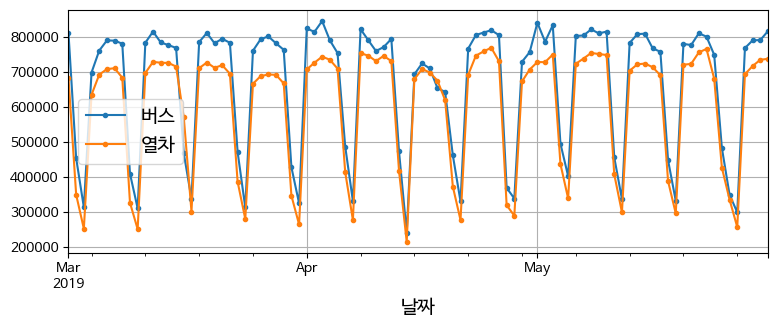

In [9]:
import matplotlib.pyplot as plt

df["2019-03":"2019-05"].plot(grid=True, marker=".", figsize=(8, 3.5))
plt.legend(["버스", "열차"]);
plt.xlabel("날짜")
save_fig("daily_ridership_plot")  # 추가 코드 - 책의 그림을 저장합니다.
plt.show()

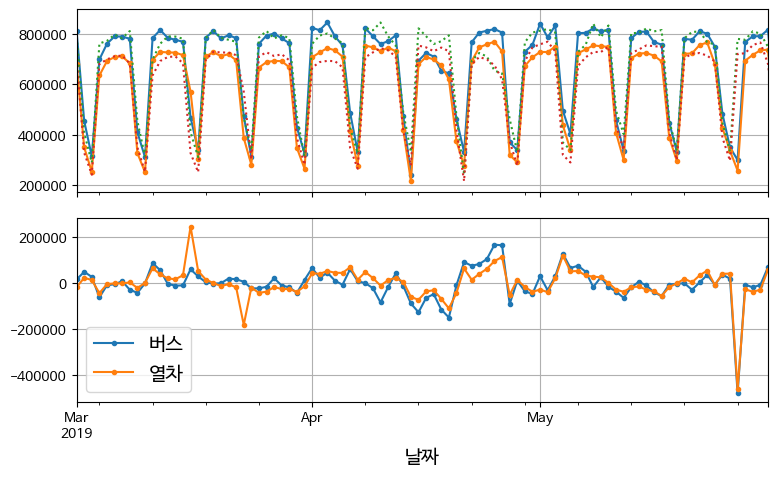

In [10]:
diff_7 = df[["bus", "rail"]].diff(7)["2019-03":"2019-05"]

fig, axs = plt.subplots(2, 1, sharex=True, figsize=(8, 5))
df.plot(ax=axs[0], legend=False, marker=".")  # 원본 시계열
df.shift(7).plot(ax=axs[0], grid=True, legend=False, linestyle=":")  # 지연
diff_7.plot(ax=axs[1], grid=True, marker=".")  # 7일 차분 시계열
axs[1].legend(["버스", "열차"])
axs[1].set_xlabel("날짜")
axs[0].set_ylim([170_000, 900_000])  # 추가 코드 - 그래프를 아름답게 꾸미기
save_fig("differencing_plot")  # 추가 코드 - 책의 그림을 저장합니다.
plt.show()

In [11]:
list(df.loc["2019-05-25":"2019-05-27"]["day_type"])

['A', 'U', 'U']

평균 절대 오차(MAE)는 평균 절대 편차(MAD)라고도 합니다:

In [12]:
diff_7.abs().mean()

bus     43915.608696
rail    42143.271739
dtype: float64

평균 절대 비율 오류(MAPE):

In [13]:
targets = df[["bus", "rail"]]["2019-03":"2019-05"]
(diff_7 / targets).abs().mean()

bus     0.082938
rail    0.089948
dtype: float64

이제 연도별 계절성과 장기 트렌드를 살펴보겠습니다:

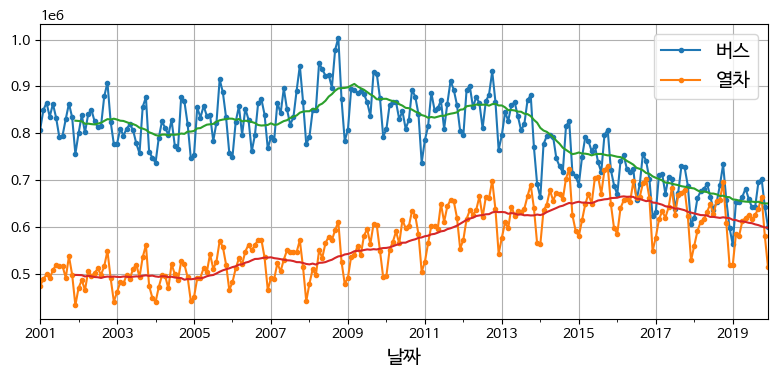

In [14]:
period = slice("2001", "2019")
df_monthly = df.resample('M').mean(numeric_only=True)  # 월별 평균을 계산합니다.
rolling_average_12_months = df_monthly[period].rolling(window=12).mean()

fig, ax = plt.subplots(figsize=(8, 4))
df_monthly[period].plot(ax=ax, marker=".")
rolling_average_12_months.plot(ax=ax, grid=True, legend=False)
ax.legend(["버스", "열차"]);
ax.set_xlabel('날짜')
save_fig("long_term_ridership_plot")  # 추가 코드 - 책의 그림을 저장합니다.
plt.show()

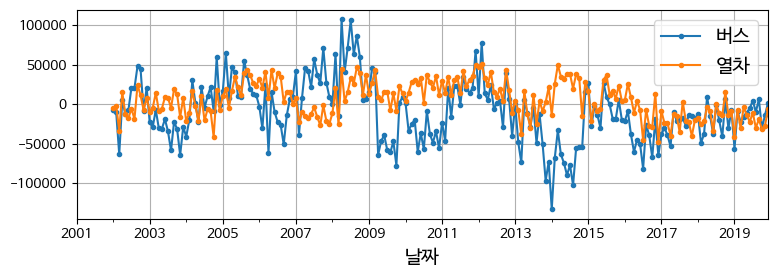

In [15]:
df_monthly.diff(12)[period].plot(grid=True, marker=".", figsize=(8, 3))
plt.legend(["버스", "열차"])
plt.xlabel("날짜")
save_fig("yearly_diff_plot")  # 추가 코드 - 책의 그림을 저장합니다.
plt.show()

Colab에서 실행하는 경우 `statsmodels` 라이브러리를 설치합니다:

In [16]:
if "google.colab" in sys.modules:
    %pip install -q -U statsmodels

In [17]:
from statsmodels.tsa.arima.model import ARIMA

origin, today = "2019-01-01", "2019-05-31"
rail_series = df.loc[origin:today]["rail"].asfreq("D")
model = ARIMA(rail_series,
              order=(1, 0, 0),
              seasonal_order=(0, 1, 1, 7))
model = model.fit()
y_pred = model.forecast()  # 427,758.6 반환

In [18]:
y_pred[0]  # ARIMA 예측

427758.6262875742

In [19]:
df["rail"].loc["2019-06-01"]  # 타깃 값

379044

In [20]:
df["rail"].loc["2019-05-25"]  # 순진한 예측(1주일 전의 값)

426932

In [21]:
origin, start_date, end_date = "2019-01-01", "2019-03-01", "2019-05-31"
time_period = pd.date_range(start_date, end_date)
rail_series = df.loc[origin:end_date]["rail"].asfreq("D")
y_preds = []
for today in time_period.shift(-1):
    model = ARIMA(rail_series[origin:today],  # "오늘"까지의 데이터로 훈련
                  order=(1, 0, 0),
                  seasonal_order=(0, 1, 1, 7))
    model = model.fit()  # 매일 모델을 재훈련한다는 점에 유의하세요!
    y_pred = model.forecast()[0]
    y_preds.append(y_pred)

y_preds = pd.Series(y_preds, index=time_period)
mae = (y_preds - rail_series[time_period]).abs().mean()  # 32,040.7 반환

In [22]:
mae

32040.7201012105

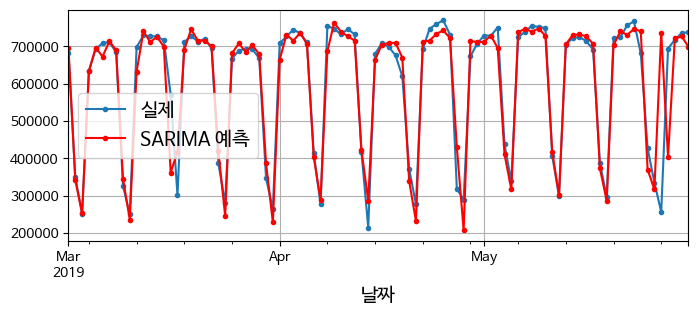

In [23]:
# 추가 코드 - SARIMA 예측을 표시합니다.
fig, ax = plt.subplots(figsize=(8, 3))
rail_series.loc[time_period].plot(label="실제", ax=ax, marker=".", grid=True)
ax.plot(y_preds, color="r", marker=".", label="SARIMA 예측")
ax.set_xlabel("날짜")
plt.legend()
plt.show()

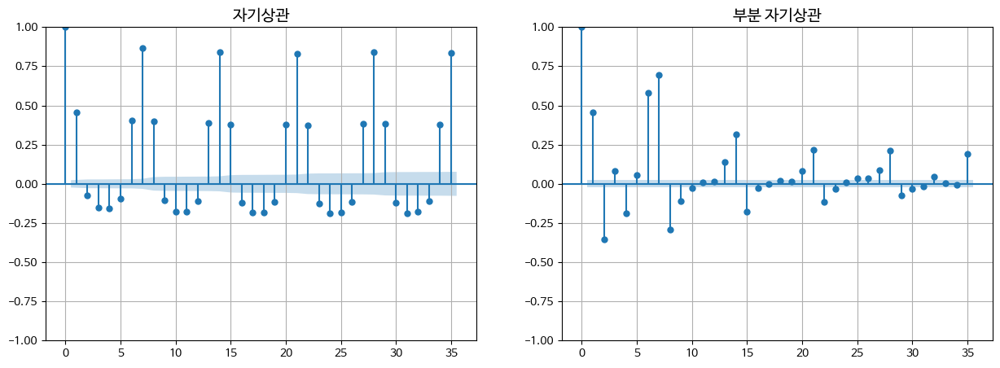

In [24]:
# 추가 코드 - 자기 상관관계 함수(ACF) 및
# 부분 자기 상관관계 함수(PACF)를 그리는 방법을 보여줍니다.

from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(15, 5))
plot_acf(df[period]["rail"], ax=axs[0], lags=35, title="자기상관")
axs[0].grid()
plot_pacf(df[period]["rail"], ax=axs[1], lags=35, method="ywm",
          title="부분 자기상관")
axs[1].grid()
plt.show()

In [25]:
import tensorflow as tf

my_series = [0, 1, 2, 3, 4, 5]
my_dataset = tf.keras.utils.timeseries_dataset_from_array(
    my_series,
    targets=my_series[3:],  # 타깃은 미래 3 스텝 앞의 값입니다.
    sequence_length=3,
    batch_size=2
)
list(my_dataset)

[(<tf.Tensor: shape=(2, 3), dtype=int32, numpy=
  array([[0, 1, 2],
         [1, 2, 3]], dtype=int32)>,
  <tf.Tensor: shape=(2,), dtype=int32, numpy=array([3, 4], dtype=int32)>),
 (<tf.Tensor: shape=(1, 3), dtype=int32, numpy=array([[2, 3, 4]], dtype=int32)>,
  <tf.Tensor: shape=(1,), dtype=int32, numpy=array([5], dtype=int32)>)]

In [26]:
for window_dataset in tf.data.Dataset.range(6).window(4, shift=1):
    for element in window_dataset:
        print(f"{element}", end=" ")
    print()

0 1 2 3 
1 2 3 4 
2 3 4 5 
3 4 5 
4 5 
5 


In [27]:
dataset = tf.data.Dataset.range(6).window(4, shift=1, drop_remainder=True)
dataset = dataset.flat_map(lambda window_dataset: window_dataset.batch(4))
for window_tensor in dataset:
    print(f"{window_tensor}")

[0 1 2 3]
[1 2 3 4]
[2 3 4 5]


In [28]:
def to_windows(dataset, length):
    dataset = dataset.window(length, shift=1, drop_remainder=True)
    return dataset.flat_map(lambda window_ds: window_ds.batch(length))

In [29]:
dataset = to_windows(tf.data.Dataset.range(6), 4)
dataset = dataset.map(lambda window: (window[:-1], window[-1]))
list(dataset.batch(2))

[(<tf.Tensor: shape=(2, 3), dtype=int64, numpy=
  array([[0, 1, 2],
         [1, 2, 3]])>,
  <tf.Tensor: shape=(2,), dtype=int64, numpy=array([3, 4])>),
 (<tf.Tensor: shape=(1, 3), dtype=int64, numpy=array([[2, 3, 4]])>,
  <tf.Tensor: shape=(1,), dtype=int64, numpy=array([5])>)]

데이터를 계속 살펴보기 전에 훈련, 검증 및 테스트를 위해 시계열을 세 가지 기간으로 나누어 보겠습니다. 지금은 테스트 데이터를 살펴보지 않겠습니다:

In [30]:
rail_train = df["rail"]["2016-01":"2018-12"] / 1e6
rail_valid = df["rail"]["2019-01":"2019-05"] / 1e6
rail_test = df["rail"]["2019-06":] / 1e6

In [31]:
seq_length = 56
tf.random.set_seed(42)  # 추가 코드 - 재현성 보장
train_ds = tf.keras.utils.timeseries_dataset_from_array(
    rail_train.to_numpy(),
    targets=rail_train[seq_length:],
    sequence_length=seq_length,
    batch_size=32,
    shuffle=True,
    seed=42
)
valid_ds = tf.keras.utils.timeseries_dataset_from_array(
    rail_valid.to_numpy(),
    targets=rail_valid[seq_length:],
    sequence_length=seq_length,
    batch_size=32
)

In [32]:
tf.random.set_seed(42)
model = tf.keras.Sequential([
    tf.keras.layers.Dense(1, input_shape=[seq_length])
])
early_stopping_cb = tf.keras.callbacks.EarlyStopping(
    monitor="val_mae", patience=50, restore_best_weights=True)
opt = tf.keras.optimizers.SGD(learning_rate=0.02, momentum=0.9)
model.compile(loss=tf.keras.losses.Huber(), optimizer=opt, metrics=["mae"])
history = model.fit(train_ds, validation_data=valid_ds, epochs=500,
                    callbacks=[early_stopping_cb])

Epoch 1/500
33/33 [==============================] - 4s 23ms/step - loss: 0.0613 - mae: 0.2763 - val_loss: 0.0075 - val_mae: 0.0918
Epoch 2/500
33/33 [==============================] - 1s 13ms/step - loss: 0.0096 - mae: 0.1031 - val_loss: 0.0050 - val_mae: 0.0731
Epoch 3/500
33/33 [==============================] - 1s 13ms/step - loss: 0.0076 - mae: 0.0913 - val_loss: 0.0045 - val_mae: 0.0716
Epoch 4/500
33/33 [==============================] - 1s 15ms/step - loss: 0.0074 - mae: 0.0915 - val_loss: 0.0042 - val_mae: 0.0688
Epoch 5/500
33/33 [==============================] - 1s 12ms/step - loss: 0.0064 - mae: 0.0825 - val_loss: 0.0046 - val_mae: 0.0723
Epoch 6/500
33/33 [==============================] - 1s 12ms/step - loss: 0.0058 - mae: 0.0778 - val_loss: 0.0046 - val_mae: 0.0728
Epoch 7/500
33/33 [==============================] - 0s 10ms/step - loss: 0.0064 - mae: 0.0835 - val_loss: 0.0037 - val_mae: 0.0625
Epoch 8/500
33/33 [==============================] - 1s 13ms/step - loss: 0.

In [33]:
# 추가 코드 - 모델을 평가합니다.
valid_loss, valid_mae = model.evaluate(valid_ds)
valid_mae * 1e6

3/3 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0377


37689.9428665638

## 간단한 RNN 사용

In [34]:
tf.random.set_seed(42)  # 추가 코드 - 재현성 보장
model = tf.keras.Sequential([
    tf.keras.layers.SimpleRNN(1, input_shape=[None, 1])
])

In [35]:
# 추가 코드 - 여러 번 재사용할 유틸리티 함수를 정의합니다.

def fit_and_evaluate(model, train_set, valid_set, learning_rate, epochs=500):
    early_stopping_cb = tf.keras.callbacks.EarlyStopping(
        monitor="val_mae", patience=50, restore_best_weights=True)
    opt = tf.keras.optimizers.SGD(learning_rate=learning_rate, momentum=0.9)
    model.compile(loss=tf.keras.losses.Huber(), optimizer=opt, metrics=["mae"])
    history = model.fit(train_set, validation_data=valid_set, epochs=epochs,
                        callbacks=[early_stopping_cb])
    valid_loss, valid_mae = model.evaluate(valid_set)
    return valid_mae * 1e6

In [36]:
fit_and_evaluate(model, train_ds, valid_ds, learning_rate=0.02)

Epoch 1/500
33/33 [==============================] - 2s 42ms/step - loss: 0.8265 - mae: 1.2813 - val_loss: 0.0323 - val_mae: 0.1650
Epoch 2/500
33/33 [==============================] - 1s 38ms/step - loss: 0.0491 - mae: 0.2483 - val_loss: 0.0521 - val_mae: 0.2636
Epoch 3/500
33/33 [==============================] - 1s 37ms/step - loss: 0.0334 - mae: 0.1858 - val_loss: 0.0253 - val_mae: 0.1570
Epoch 4/500
33/33 [==============================] - 1s 37ms/step - loss: 0.0241 - mae: 0.1788 - val_loss: 0.0234 - val_mae: 0.1616
Epoch 5/500
33/33 [==============================] - 1s 37ms/step - loss: 0.0232 - mae: 0.1750 - val_loss: 0.0229 - val_mae: 0.1567
Epoch 6/500
33/33 [==============================] - 2s 56ms/step - loss: 0.0225 - mae: 0.1724 - val_loss: 0.0222 - val_mae: 0.1539
Epoch 7/500
33/33 [==============================] - 2s 47ms/step - loss: 0.0219 - mae: 0.1711 - val_loss: 0.0214 - val_mae: 0.1518
Epoch 8/500
33/33 [==============================] - 1s 36ms/step - loss: 0.

102789.93844985962

In [37]:
tf.random.set_seed(42)  # 추가 코드 - 재현성 보장
univar_model = tf.keras.Sequential([
    tf.keras.layers.SimpleRNN(32, input_shape=[None, 1]),
    tf.keras.layers.Dense(1)  # 기본적으로 활성화 함수 없음
])

In [38]:
# 추가 코드 - 이전과 같이 모델을 컴파일, 훈련 및 평가합니다.
fit_and_evaluate(univar_model, train_ds, valid_ds, learning_rate=0.05)

Epoch 1/500
33/33 [==============================] - 3s 61ms/step - loss: 0.0403 - mae: 0.2028 - val_loss: 0.0081 - val_mae: 0.1103
Epoch 2/500
33/33 [==============================] - 1s 36ms/step - loss: 0.0064 - mae: 0.0854 - val_loss: 0.0026 - val_mae: 0.0516
Epoch 3/500
33/33 [==============================] - 1s 36ms/step - loss: 0.0042 - mae: 0.0627 - val_loss: 0.0026 - val_mae: 0.0492
Epoch 4/500
33/33 [==============================] - 1s 37ms/step - loss: 0.0039 - mae: 0.0595 - val_loss: 0.0022 - val_mae: 0.0412
Epoch 5/500
33/33 [==============================] - 1s 38ms/step - loss: 0.0044 - mae: 0.0674 - val_loss: 0.0027 - val_mae: 0.0527
Epoch 6/500
33/33 [==============================] - 1s 38ms/step - loss: 0.0035 - mae: 0.0546 - val_loss: 0.0021 - val_mae: 0.0381
Epoch 7/500
33/33 [==============================] - 1s 35ms/step - loss: 0.0035 - mae: 0.0549 - val_loss: 0.0022 - val_mae: 0.0379
Epoch 8/500
33/33 [==============================] - 1s 36ms/step - loss: 0.

29859.421774744987

## 심층 RNN

In [39]:
tf.random.set_seed(42)  # 추가 코드 - 재현성 보장
deep_model = tf.keras.Sequential([
    tf.keras.layers.SimpleRNN(32, return_sequences=True, input_shape=[None, 1]),
    tf.keras.layers.SimpleRNN(32, return_sequences=True),
    tf.keras.layers.SimpleRNN(32),
    tf.keras.layers.Dense(1)
])

In [40]:
# 추가 코드 - 이전과 같이 모델을 컴파일, 훈련 및 평가합니다.
fit_and_evaluate(deep_model, train_ds, valid_ds, learning_rate=0.01)

Epoch 1/500
33/33 [==============================] - 7s 139ms/step - loss: 0.0809 - mae: 0.2820 - val_loss: 0.0229 - val_mae: 0.1299
Epoch 2/500
33/33 [==============================] - 5s 164ms/step - loss: 0.0181 - mae: 0.1602 - val_loss: 0.0175 - val_mae: 0.1218
Epoch 3/500
33/33 [==============================] - 4s 127ms/step - loss: 0.0162 - mae: 0.1548 - val_loss: 0.0143 - val_mae: 0.1417
Epoch 4/500
33/33 [==============================] - 6s 167ms/step - loss: 0.0153 - mae: 0.1513 - val_loss: 0.0142 - val_mae: 0.1213
Epoch 5/500
33/33 [==============================] - 4s 124ms/step - loss: 0.0136 - mae: 0.1428 - val_loss: 0.0123 - val_mae: 0.1078
Epoch 6/500
33/33 [==============================] - 5s 166ms/step - loss: 0.0116 - mae: 0.1258 - val_loss: 0.0078 - val_mae: 0.0933
Epoch 7/500
33/33 [==============================] - 4s 128ms/step - loss: 0.0137 - mae: 0.1330 - val_loss: 0.0087 - val_mae: 0.1128
Epoch 8/500
33/33 [==============================] - 5s 165ms/step - 

29393.045231699944

## 다변량 시계열

In [41]:
df_mulvar = df[["bus", "rail"]] / 1e6  # 버스 및 열차 시계열을 모두 입력으로 사용
df_mulvar["next_day_type"] = df["day_type"].shift(-1)  # 내일의 유형을 알고 있습니다.
df_mulvar = pd.get_dummies(df_mulvar)  # 요일 유형을 원-핫 인코딩합니다.

In [42]:
mulvar_train = df_mulvar["2016-01":"2018-12"]
mulvar_valid = df_mulvar["2019-01":"2019-05"]
mulvar_test = df_mulvar["2019-06":]

In [44]:
import numpy as np

tf.random.set_seed(42)  # 추가 코드 - 재현성 보장

train_mulvar_ds = tf.keras.utils.timeseries_dataset_from_array(
    mulvar_train.to_numpy(np.float32),  # 5개의 열을 모두 입력으로 사용
    targets=mulvar_train["rail"][seq_length:],  # 열차 시계열만 예측
    sequence_length=seq_length,
    batch_size=32,
    shuffle=True,
    seed=42
)
valid_mulvar_ds = tf.keras.utils.timeseries_dataset_from_array(
    mulvar_valid.to_numpy(np.float32),
    targets=mulvar_valid["rail"][seq_length:],
    sequence_length=seq_length,
    batch_size=32
)

In [45]:
tf.random.set_seed(42)  # 추가 코드 - 재현성 보장
mulvar_model = tf.keras.Sequential([
    tf.keras.layers.SimpleRNN(32, input_shape=[None, 5]),
    tf.keras.layers.Dense(1)
])

In [46]:
# 추가 코드 - 이전과 같이 모델을 컴파일, 훈련 및 평가합니다.
fit_and_evaluate(mulvar_model, train_mulvar_ds, valid_mulvar_ds,
                 learning_rate=0.05)

Epoch 1/500
33/33 [==============================] - 4s 77ms/step - loss: 0.0118 - mae: 0.1107 - val_loss: 0.0017 - val_mae: 0.0448
Epoch 2/500
33/33 [==============================] - 1s 38ms/step - loss: 0.0032 - mae: 0.0599 - val_loss: 0.0020 - val_mae: 0.0510
Epoch 3/500
33/33 [==============================] - 1s 37ms/step - loss: 0.0019 - mae: 0.0417 - val_loss: 8.0227e-04 - val_mae: 0.0296
Epoch 4/500
33/33 [==============================] - 1s 36ms/step - loss: 0.0019 - mae: 0.0430 - val_loss: 8.5176e-04 - val_mae: 0.0312
Epoch 5/500
33/33 [==============================] - 1s 37ms/step - loss: 0.0016 - mae: 0.0377 - val_loss: 7.0553e-04 - val_mae: 0.0273
Epoch 6/500
33/33 [==============================] - 1s 37ms/step - loss: 0.0016 - mae: 0.0396 - val_loss: 6.4280e-04 - val_mae: 0.0253
Epoch 7/500
33/33 [==============================] - 1s 36ms/step - loss: 0.0016 - mae: 0.0397 - val_loss: 7.3714e-04 - val_mae: 0.0287
Epoch 8/500
33/33 [==============================] - 1s 

23170.00925540924

In [48]:
# 추가 코드 - 버스와 열차를 모두 예측하는 멀티태스크 RNN 구축 및 훈련

tf.random.set_seed(42)

seq_length = 56
train_multask_ds = tf.keras.utils.timeseries_dataset_from_array(
    mulvar_train.to_numpy(np.float32),
    targets=mulvar_train[["bus", "rail"]][seq_length:],  # 타깃 2개
    sequence_length=seq_length,
    batch_size=32,
    shuffle=True,
    seed=42
)
valid_multask_ds = tf.keras.utils.timeseries_dataset_from_array(
    mulvar_valid.to_numpy(np.float32),
    targets=mulvar_valid[["bus", "rail"]][seq_length:],
    sequence_length=seq_length,
    batch_size=32
)

tf.random.set_seed(42)
multask_model = tf.keras.Sequential([
    tf.keras.layers.SimpleRNN(32, input_shape=[None, 5]),
    tf.keras.layers.Dense(2)
])

fit_and_evaluate(multask_model, train_multask_ds, valid_multask_ds,
                 learning_rate=0.02)

Epoch 1/500
33/33 [==============================] - 2s 43ms/step - loss: 0.0688 - mae: 0.2395 - val_loss: 0.0062 - val_mae: 0.0955
Epoch 2/500
33/33 [==============================] - 2s 60ms/step - loss: 0.0037 - mae: 0.0627 - val_loss: 0.0011 - val_mae: 0.0370
Epoch 3/500
33/33 [==============================] - 1s 37ms/step - loss: 0.0020 - mae: 0.0437 - val_loss: 9.4993e-04 - val_mae: 0.0329
Epoch 4/500
33/33 [==============================] - 1s 37ms/step - loss: 0.0018 - mae: 0.0426 - val_loss: 0.0014 - val_mae: 0.0411
Epoch 5/500
33/33 [==============================] - 1s 37ms/step - loss: 0.0018 - mae: 0.0418 - val_loss: 0.0011 - val_mae: 0.0367
Epoch 6/500
33/33 [==============================] - 1s 36ms/step - loss: 0.0018 - mae: 0.0424 - val_loss: 7.8634e-04 - val_mae: 0.0291
Epoch 7/500
33/33 [==============================] - 2s 50ms/step - loss: 0.0017 - mae: 0.0403 - val_loss: 7.2800e-04 - val_mae: 0.0276
Epoch 8/500
33/33 [==============================] - 1s 39ms/ste

24065.645411610603

In [49]:
# 추가 코드 - 버스에 대한 순진한 예측을 평가합니다.
bus_naive = mulvar_valid["bus"].shift(7)[seq_length:]
bus_target = mulvar_valid["bus"][seq_length:]
(bus_target - bus_naive).abs().mean() * 1e6

43441.63157894738

In [50]:
# 추가 코드 - 버스와 열차 모두에 대한 멀티태스크 RNN의 예측을 평가합니다.
Y_preds_valid = multask_model.predict(valid_multask_ds)
for idx, name in enumerate(["bus", "rail"]):
    mae = 1e6 * tf.keras.metrics.mean_absolute_error(
        mulvar_valid[name][seq_length:], Y_preds_valid[:, idx])
    print(name, int(mae))

3/3 [==============================] - 0s 10ms/step
bus 25166
rail 22964


## 여러 스텝 앞을 예측하기

In [51]:
import numpy as np

X = rail_valid.to_numpy()[np.newaxis, :seq_length, np.newaxis]
for step_ahead in range(14):
    y_pred_one = univar_model.predict(X)
    X = np.concatenate([X, y_pred_one.reshape(1, 1, 1)], axis=1)

1/1 [==============================] - 0s 22ms/step


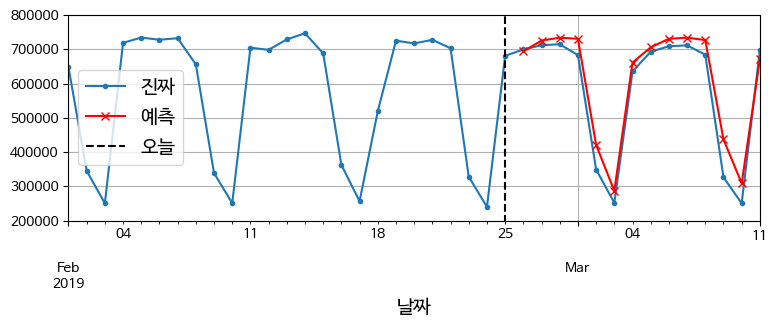

In [52]:
# 추가 코드 - 그림 15-11 생성 및 저장

# 예측은 2019년 57일째인 2019-02-26에 시작하여 2019-03-11에 종료됩니다. 총 14일입니다.
Y_pred = pd.Series(X[0, -14:, 0],
                   index=pd.date_range("2019-02-26", "2019-03-11"))

fig, ax = plt.subplots(figsize=(8, 3.5))
(rail_valid * 1e6)["2019-02-01":"2019-03-11"].plot(
    label="진짜", marker=".", ax=ax)
(Y_pred * 1e6).plot(
    label="예측", grid=True, marker="x", color="r", ax=ax)
ax.vlines("2019-02-25", 0, 1e6, color="k", linestyle="--", label="오늘")
ax.set_ylim([200_000, 800_000])
ax.set_xlabel("날짜")
plt.legend(loc="center left")
save_fig("forecast_ahead_plot")
plt.show()

이제 14개의 다음 값을 한 번에 모두 예측하는 RNN을 만들어 보겠습니다:

In [54]:
tf.random.set_seed(42)  # 추가 코드 - 재현성 보장

def split_inputs_and_targets(mulvar_series, ahead=14, target_col=1):
    return mulvar_series[:, :-ahead], mulvar_series[:, -ahead:, target_col]

ahead_train_ds = tf.keras.utils.timeseries_dataset_from_array(
    mulvar_train.to_numpy(np.float32),
    targets=None,
    sequence_length=seq_length + 14,
    batch_size=32,
    shuffle=True,
    seed=42
).map(split_inputs_and_targets)
ahead_valid_ds = tf.keras.utils.timeseries_dataset_from_array(
    mulvar_valid.to_numpy(np.float32),
    targets=None,
    sequence_length=seq_length + 14,
    batch_size=32
).map(split_inputs_and_targets)

In [55]:
tf.random.set_seed(42)

ahead_model = tf.keras.Sequential([
    tf.keras.layers.SimpleRNN(32, input_shape=[None, 5]),
    tf.keras.layers.Dense(14)
])

In [56]:
# 추가 코드 - 이전과 같이 모델을 컴파일, 훈련 및 평가합니다.
fit_and_evaluate(ahead_model, ahead_train_ds, ahead_valid_ds,
                 learning_rate=0.02)

Epoch 1/500
33/33 [==============================] - 6s 103ms/step - loss: 0.1267 - mae: 0.3909 - val_loss: 0.0234 - val_mae: 0.1729
Epoch 2/500
33/33 [==============================] - 3s 95ms/step - loss: 0.0177 - mae: 0.1475 - val_loss: 0.0101 - val_mae: 0.1125
Epoch 3/500
33/33 [==============================] - 3s 73ms/step - loss: 0.0114 - mae: 0.1170 - val_loss: 0.0074 - val_mae: 0.0964
Epoch 4/500
33/33 [==============================] - 2s 67ms/step - loss: 0.0091 - mae: 0.1026 - val_loss: 0.0055 - val_mae: 0.0836
Epoch 5/500
33/33 [==============================] - 1s 34ms/step - loss: 0.0077 - mae: 0.0925 - val_loss: 0.0046 - val_mae: 0.0763
Epoch 6/500
33/33 [==============================] - 1s 34ms/step - loss: 0.0069 - mae: 0.0853 - val_loss: 0.0037 - val_mae: 0.0686
Epoch 7/500
33/33 [==============================] - 1s 35ms/step - loss: 0.0062 - mae: 0.0798 - val_loss: 0.0033 - val_mae: 0.0636
Epoch 8/500
33/33 [==============================] - 1s 37ms/step - loss: 0

35993.34880709648

In [62]:
X = mulvar_valid.to_numpy(np.float32)[np.newaxis, :seq_length]  # 크기 [1, 56, 5]
Y_pred = ahead_model.predict(X)  # 크기 [1, 14]

1/1 [==============================] - 0s 37ms/step


이제 각 타임 스텝에서 다음 14스텝을 예측하는 RNN을 만들어 보겠습니다. 즉, 타임 스텝 0\~55를 기준으로 타임 스텝 56\~69를 예측하는 대신 타임 스텝 0에서 타임 스텝 1\~14를 예측하고, 타임 스텝 1에서 타임 스텝 2\~15를 예측하는 식으로 예측하고, 마지막 타임 스텝에서 타임 스텝 56\~69를 예측합니다. 이 모델은 코잘(causal) 모델이므로 어떤 타임 스텝에서든 예측을 할 때는 과거의 타임 스텝만 볼 수 있습니다.

데이터셋을 준비하기 위해 `to_windows()`를 두 번 사용하여 다음과 같이 연속된 윈도의 시퀀스를 가져올 수 있습니다:

In [63]:
my_series = tf.data.Dataset.range(7)
dataset = to_windows(to_windows(my_series, 3), 4)
list(dataset)

[<tf.Tensor: shape=(4, 3), dtype=int64, numpy=
 array([[0, 1, 2],
        [1, 2, 3],
        [2, 3, 4],
        [3, 4, 5]])>,
 <tf.Tensor: shape=(4, 3), dtype=int64, numpy=
 array([[1, 2, 3],
        [2, 3, 4],
        [3, 4, 5],
        [4, 5, 6]])>]

그런 다음 원소를 원하는 입력과 타깃으로 분할할 수 있습니다:

In [64]:
dataset = dataset.map(lambda S: (S[:, 0], S[:, 1:]))
list(dataset)

[(<tf.Tensor: shape=(4,), dtype=int64, numpy=array([0, 1, 2, 3])>,
  <tf.Tensor: shape=(4, 2), dtype=int64, numpy=
  array([[1, 2],
         [2, 3],
         [3, 4],
         [4, 5]])>),
 (<tf.Tensor: shape=(4,), dtype=int64, numpy=array([1, 2, 3, 4])>,
  <tf.Tensor: shape=(4, 2), dtype=int64, numpy=
  array([[2, 3],
         [3, 4],
         [4, 5],
         [5, 6]])>)]

이 아이디어를 유틸리티 함수로 만들어 봅시다. 이 함수는 셔플(선택 사항)과 배치 처리도 담당합니다:

In [68]:
def to_seq2seq_dataset(series, seq_length=56, ahead=14, target_col=1,
                       batch_size=32, shuffle=False, seed=None):
    ds = to_windows(tf.data.Dataset.from_tensor_slices(
        series.to_numpy(np.float32)), ahead + 1)
    ds = to_windows(ds, seq_length).map(lambda S: (S[:, 0], S[:, 1:, 1]))
    if shuffle:
        ds = ds.shuffle(8 * batch_size, seed=seed)
    return ds.batch(batch_size)

In [69]:
seq2seq_train = to_seq2seq_dataset(mulvar_train, shuffle=True, seed=42)
seq2seq_valid = to_seq2seq_dataset(mulvar_valid)

In [70]:
tf.random.set_seed(42)  # 추가 코드 - 재현성 보장
seq2seq_model = tf.keras.Sequential([
    tf.keras.layers.SimpleRNN(32, return_sequences=True, input_shape=[None, 5]),
    tf.keras.layers.Dense(14)
    # tf.keras.layers.TimeDistributed(tf.keras.layers.Dense(14))나
    # tf.keras.layers.Conv1D(14, kernel_size=1) 와 동일합니다
])

In [71]:
fit_and_evaluate(seq2seq_model, seq2seq_train, seq2seq_valid,
                 learning_rate=0.1)

Epoch 1/500
33/33 [==============================] - 3s 48ms/step - loss: 0.0687 - mae: 0.2596 - val_loss: 0.0156 - val_mae: 0.1363
Epoch 2/500
33/33 [==============================] - 2s 64ms/step - loss: 0.0095 - mae: 0.1038 - val_loss: 0.0077 - val_mae: 0.0878
Epoch 3/500
33/33 [==============================] - 1s 43ms/step - loss: 0.0066 - mae: 0.0823 - val_loss: 0.0065 - val_mae: 0.0779
Epoch 4/500
33/33 [==============================] - 2s 44ms/step - loss: 0.0058 - mae: 0.0743 - val_loss: 0.0059 - val_mae: 0.0734
Epoch 5/500
33/33 [==============================] - 2s 46ms/step - loss: 0.0053 - mae: 0.0702 - val_loss: 0.0052 - val_mae: 0.0675
Epoch 6/500
33/33 [==============================] - 2s 46ms/step - loss: 0.0051 - mae: 0.0684 - val_loss: 0.0055 - val_mae: 0.0709
Epoch 7/500
33/33 [==============================] - 2s 71ms/step - loss: 0.0049 - mae: 0.0665 - val_loss: 0.0050 - val_mae: 0.0661
Epoch 8/500
33/33 [==============================] - 2s 52ms/step - loss: 0.

48140.85364341736

In [73]:
X = mulvar_valid.to_numpy(np.float32)[np.newaxis, :seq_length]
y_pred_14 = seq2seq_model.predict(X)[0, -1]  # 마지막 타임 스텝의 출력만

1/1 [==============================] - 0s 229ms/step


In [74]:
Y_pred_valid = seq2seq_model.predict(seq2seq_valid)
for ahead in range(14):
    preds = pd.Series(Y_pred_valid[:-1, -1, ahead],
                      index=mulvar_valid.index[56 + ahead : -14 + ahead])
    mae = (preds - mulvar_valid["rail"]).abs().mean() * 1e6
    print(f"MAE for +{ahead + 1}: {mae:,.0f}")

3/3 [==============================] - 0s 14ms/step
MAE for +1: 24,861
MAE for +2: 31,069
MAE for +3: 30,421
MAE for +4: 33,405
MAE for +5: 33,330
MAE for +6: 34,681
MAE for +7: 33,834
MAE for +8: 34,362
MAE for +9: 32,654
MAE for +10: 32,744
MAE for +11: 36,629
MAE for +12: 37,323
MAE for +13: 36,500
MAE for +14: 37,483


# 층 정규화를 사용한 심층 RNN

In [75]:
class LNSimpleRNNCell(tf.keras.layers.Layer):
    def __init__(self, units, activation="tanh", **kwargs):
        super().__init__(**kwargs)
        self.state_size = units
        self.output_size = units
        self.simple_rnn_cell = tf.keras.layers.SimpleRNNCell(units,
                                                             activation=None)
        self.layer_norm = tf.keras.layers.LayerNormalization()
        self.activation = tf.keras.activations.get(activation)

    def call(self, inputs, states):
        outputs, new_states = self.simple_rnn_cell(inputs, states)
        norm_outputs = self.activation(self.layer_norm(outputs))
        return norm_outputs, [norm_outputs]

In [76]:
tf.random.set_seed(42)  # 추가 코드 - 재현성 보장
custom_ln_model = tf.keras.Sequential([
    tf.keras.layers.RNN(LNSimpleRNNCell(32), return_sequences=True,
                        input_shape=[None, 5]),
    tf.keras.layers.Dense(14)
])

5에포크 동안만 훈련하면 효과가 있다는 것을 알 수 있습니다(원하는 경우 더 늘릴 수 있습니다):

In [77]:
fit_and_evaluate(custom_ln_model, seq2seq_train, seq2seq_valid,
                 learning_rate=0.1, epochs=5)

Epoch 1/5
33/33 [==============================] - 5s 101ms/step - loss: 0.1042 - mae: 0.3203 - val_loss: 0.0229 - val_mae: 0.1605
Epoch 2/5
33/33 [==============================] - 4s 100ms/step - loss: 0.0147 - mae: 0.1427 - val_loss: 0.0140 - val_mae: 0.1251
Epoch 3/5
33/33 [==============================] - 3s 83ms/step - loss: 0.0116 - mae: 0.1248 - val_loss: 0.0126 - val_mae: 0.1119
Epoch 4/5
33/33 [==============================] - 3s 84ms/step - loss: 0.0100 - mae: 0.1120 - val_loss: 0.0110 - val_mae: 0.1036
Epoch 5/5
3/3 [==============================] - 0s 62ms/step - loss: 0.0094 - mae: 0.0965


96505.7983994484

# 추가 자료 - 사용자 정의 RNN 클래스 만들기

RNN 클래스는 마법이 아닙니다. 사실, 자신만의 RNN 클래스를 구현하는 것은 그리 어렵지 않습니다:

In [78]:
class MyRNN(tf.keras.layers.Layer):
    def __init__(self, cell, return_sequences=False, **kwargs):
        super().__init__(**kwargs)
        self.cell = cell
        self.return_sequences = return_sequences

    def get_initial_state(self, inputs):
        try:
            return self.cell.get_initial_state(inputs)
        except AttributeError:
            # self.cell에 get_initial_state() 메서드가 없는 경우 0으로 돌아갑니다.
            batch_size = tf.shape(inputs)[0]
            return [tf.zeros([batch_size, self.cell.state_size],
                             dtype=inputs.dtype)]

    @tf.function
    def call(self, inputs):
        states = self.get_initial_state(inputs)
        shape = tf.shape(inputs)
        batch_size = shape[0]
        n_steps = shape[1]
        sequences = tf.TensorArray(
            inputs.dtype, size=(n_steps if self.return_sequences else 0))
        outputs = tf.zeros(shape=[batch_size, self.cell.output_size],
                           dtype=inputs.dtype)
        for step in tf.range(n_steps):
            outputs, states = self.cell(inputs[:, step], states)
            if self.return_sequences:
                sequences = sequences.write(step, outputs)

        if self.return_sequences:
            # 출력을 [time steps, batch size, dims] 크기의 배열로 쌓습니다.
            # 그다음 전치하여 [batch size, time steps, dims] 크기로 만듭니다.
            return tf.transpose(sequences.stack(), [1, 0, 2])
        else:
            return outputs

`@tf.function`은 `for` 루프 전에 `output` 변수를 생성해야 하므로, 해당 값을 전혀 사용하지 않더라도 그 값을 0 텐서로 초기화합니다. 함수가 그래프로 변환되면 이 사용되지 않은 값은 그래프에서 잘려나가므로 성능에 영향을 미치지 않습니다. 마찬가지로 `@tf.function`은 `self.return_sequences`가 `False`인 경우에도 `sequences` 변수가 사용되는 `if` 문 앞에 생성되어야 하므로, 이 경우에는 0 크기의 `TensorArray`를 생성합니다.

In [79]:
tf.random.set_seed(42)

custom_model = tf.keras.Sequential([
    MyRNN(LNSimpleRNNCell(32), return_sequences=True, input_shape=[None, 5]),
    tf.keras.layers.Dense(14)
])

5에포크 동안만 훈련하면 효과가 있다는 것을 알 수 있습니다(원하는 경우 더 늘릴 수 있습니다):

In [80]:
fit_and_evaluate(custom_model, seq2seq_train, seq2seq_valid,
                 learning_rate=0.1, epochs=5)

Epoch 1/5
33/33 [==============================] - 4s 97ms/step - loss: 0.0743 - mae: 0.2698 - val_loss: 0.0185 - val_mae: 0.1524
Epoch 2/5
33/33 [==============================] - 3s 95ms/step - loss: 0.0151 - mae: 0.1452 - val_loss: 0.0161 - val_mae: 0.1298
Epoch 3/5
33/33 [==============================] - 4s 131ms/step - loss: 0.0128 - mae: 0.1322 - val_loss: 0.0141 - val_mae: 0.1228
Epoch 4/5
33/33 [==============================] - 3s 92ms/step - loss: 0.0116 - mae: 0.1240 - val_loss: 0.0134 - val_mae: 0.1161
Epoch 5/5
3/3 [==============================] - 0s 34ms/step - loss: 0.0118 - mae: 0.1103


110336.87740564346

# LSTM

In [81]:
tf.random.set_seed(42)  # 추가 코드 - 재현성 보장
lstm_model = tf.keras.models.Sequential([
    tf.keras.layers.LSTM(32, return_sequences=True, input_shape=[None, 5]),
    tf.keras.layers.Dense(14)
])

5에포크 동안만 훈련하면 효과가 있다는 것을 알 수 있습니다(원하는 경우 더 늘릴 수 있습니다):

In [82]:
fit_and_evaluate(lstm_model, seq2seq_train, seq2seq_valid,
                 learning_rate=0.1, epochs=5)

Epoch 1/5
33/33 [==============================] - 3s 28ms/step - loss: 0.0455 - mae: 0.2340 - val_loss: 0.0190 - val_mae: 0.1569
Epoch 2/5
33/33 [==============================] - 0s 12ms/step - loss: 0.0169 - mae: 0.1563 - val_loss: 0.0175 - val_mae: 0.1445
Epoch 3/5
33/33 [==============================] - 0s 12ms/step - loss: 0.0156 - mae: 0.1513 - val_loss: 0.0169 - val_mae: 0.1396
Epoch 4/5
33/33 [==============================] - 0s 13ms/step - loss: 0.0149 - mae: 0.1469 - val_loss: 0.0161 - val_mae: 0.1366
Epoch 5/5
3/3 [==============================] - 0s 13ms/step - loss: 0.0155 - mae: 0.1332


133212.31305599213

# GRU

In [83]:
tf.random.set_seed(42)  # 추가 코드 - 재현성 보장
gru_model = tf.keras.Sequential([
    tf.keras.layers.GRU(32, return_sequences=True, input_shape=[None, 5]),
    tf.keras.layers.Dense(14)
])

5에포크 동안만 훈련하면 효과가 있다는 것을 알 수 있습니다(원하는 경우 더 늘릴 수 있습니다):

In [84]:
fit_and_evaluate(gru_model, seq2seq_train, seq2seq_valid,
                 learning_rate=0.1, epochs=5)

Epoch 1/5
33/33 [==============================] - 3s 24ms/step - loss: 0.0550 - mae: 0.2533 - val_loss: 0.0188 - val_mae: 0.1585
Epoch 2/5
33/33 [==============================] - 0s 13ms/step - loss: 0.0152 - mae: 0.1430 - val_loss: 0.0145 - val_mae: 0.1338
Epoch 3/5
33/33 [==============================] - 0s 12ms/step - loss: 0.0128 - mae: 0.1317 - val_loss: 0.0133 - val_mae: 0.1255
Epoch 4/5
33/33 [==============================] - 0s 12ms/step - loss: 0.0117 - mae: 0.1243 - val_loss: 0.0125 - val_mae: 0.1200
Epoch 5/5
3/3 [==============================] - 0s 13ms/step - loss: 0.0119 - mae: 0.1161


116149.95449781418

## 1D 합성곱 층으로 시퀀스 다루기

```
  |-----0-----|      |-----3----|      |--... |-------52------|
         |-----1----|      |-----4----|   ... |       |-------53------|
               |-----2----|     |------5--...-51------|       |-------54------|
X:  0  1  2  3  4  5  6  7  8  9 10 11 12 ...  104 105 106 107 108 109 110 111
Y:      from 4     6     8    10    12    ...      106     108     110     112
         to 17    19    21    23    25    ...      119     121     123     125
```

In [85]:
tf.random.set_seed(42)  # 추가 코드 - 재현성 보장
conv_rnn_model = tf.keras.Sequential([
    tf.keras.layers.Conv1D(filters=32, kernel_size=4, strides=2,
                           activation="relu", input_shape=[None, 5]),
    tf.keras.layers.GRU(32, return_sequences=True),
    tf.keras.layers.Dense(14)
])

longer_train = to_seq2seq_dataset(mulvar_train, seq_length=112,
                                       shuffle=True, seed=42)
longer_valid = to_seq2seq_dataset(mulvar_valid, seq_length=112)
downsampled_train = longer_train.map(lambda X, Y: (X, Y[:, 3::2]))
downsampled_valid = longer_valid.map(lambda X, Y: (X, Y[:, 3::2]))

5에포크 동안만 훈련하면 효과가 있다는 것을 알 수 있습니다(원하는 경우 더 늘릴 수 있습니다):

In [86]:
fit_and_evaluate(conv_rnn_model, downsampled_train, downsampled_valid,
                 learning_rate=0.1, epochs=5)

Epoch 1/5
31/31 [==============================] - 4s 30ms/step - loss: 0.0528 - mae: 0.2541 - val_loss: 0.0215 - val_mae: 0.1576
Epoch 2/5
31/31 [==============================] - 0s 13ms/step - loss: 0.0166 - mae: 0.1532 - val_loss: 0.0174 - val_mae: 0.1388
Epoch 3/5
31/31 [==============================] - 1s 14ms/step - loss: 0.0142 - mae: 0.1426 - val_loss: 0.0156 - val_mae: 0.1309
Epoch 4/5
31/31 [==============================] - 1s 14ms/step - loss: 0.0127 - mae: 0.1324 - val_loss: 0.0141 - val_mae: 0.1229
Epoch 5/5
1/1 [==============================] - 0s 65ms/step - loss: 0.0125 - mae: 0.1165


116495.54967880249

## WaveNet

```
 ⋮
C2  /\ /\ /\ /\ /\ /\ /\ /\ /\ /\ /\ /\ /\...
   \  /  \  /  \  /  \  /  \  /  \  /  \     
     /    \      /    \      /    \          
C1  /\ /\ /\ /\ /\ /\ /\ /\ /\ /\ /\  /\ /...\
X: 0  1  2  3  4  5  6  7  8  9  10 11 12 ... 111
Y: 1  2  3  4  5  6  7  8  9  10 11 12 13 ... 112
 /14 15 16 17 18 19 20 21 22  23 24 25 26 ... 125
```

In [87]:
tf.random.set_seed(42)  # 추가 코드 - 재현성 보장
wavenet_model = tf.keras.Sequential()
wavenet_model.add(tf.keras.layers.InputLayer(input_shape=[None, 5]))
for rate in (1, 2, 4, 8) * 2:
    wavenet_model.add(tf.keras.layers.Conv1D(
        filters=32, kernel_size=2, padding="causal", activation="relu",
        dilation_rate=rate))
wavenet_model.add(tf.keras.layers.Conv1D(filters=14, kernel_size=1))

5에포크 동안만 훈련하면 효과가 있다는 것을 알 수 있습니다(원하는 경우 더 늘릴 수 있습니다):

In [88]:
fit_and_evaluate(wavenet_model, longer_train, longer_valid,
                 learning_rate=0.1, epochs=5)

Epoch 1/5
31/31 [==============================] - 5s 49ms/step - loss: 0.0779 - mae: 0.3122 - val_loss: 0.0227 - val_mae: 0.1575
Epoch 2/5
31/31 [==============================] - 1s 14ms/step - loss: 0.0167 - mae: 0.1578 - val_loss: 0.0184 - val_mae: 0.1495
Epoch 3/5
31/31 [==============================] - 1s 17ms/step - loss: 0.0153 - mae: 0.1527 - val_loss: 0.0174 - val_mae: 0.1457
Epoch 4/5
31/31 [==============================] - 1s 27ms/step - loss: 0.0143 - mae: 0.1462 - val_loss: 0.0159 - val_mae: 0.1367
Epoch 5/5
1/1 [==============================] - 0s 62ms/step - loss: 0.0137 - mae: 0.1253


125281.87036514282

# 추가 자료 – Wavenet 구현

다음은 논문에 정의된 WaveNet 구현입니다. ReLU와 파라미터를 가진 스킵 연결 대신 게이트 활성화 유닛(Gated Activation Unit)을 사용하며, 시퀀스가 점점 짧아지는 것을 방지하기 위해 왼쪽에 0으로 패딩합니다:

In [89]:
class GatedActivationUnit(tf.keras.layers.Layer):
    def __init__(self, activation="tanh", **kwargs):
        super().__init__(**kwargs)
        self.activation = tf.keras.activations.get(activation)

    def call(self, inputs):
        n_filters = inputs.shape[-1] // 2
        linear_output = self.activation(inputs[..., :n_filters])
        gate = tf.keras.activations.sigmoid(inputs[..., n_filters:])
        return self.activation(linear_output) * gate

In [90]:
def wavenet_residual_block(inputs, n_filters, dilation_rate):
    z = tf.keras.layers.Conv1D(2 * n_filters, kernel_size=2, padding="causal",
                            dilation_rate=dilation_rate)(inputs)
    z = GatedActivationUnit()(z)
    z = tf.keras.layers.Conv1D(n_filters, kernel_size=1)(z)
    return tf.keras.layers.Add()([z, inputs]), z

In [91]:
tf.random.set_seed(42)

n_layers_per_block = 3  # 논문에서는 10
n_blocks = 1  # 논문에서는 3
n_filters = 32  # 논문에서는 128
n_outputs = 14  # 논문에서는 256

inputs = tf.keras.layers.Input(shape=[None, 5])
z = tf.keras.layers.Conv1D(n_filters, kernel_size=2, padding="causal")(inputs)
skip_to_last = []
for dilation_rate in [2**i for i in range(n_layers_per_block)] * n_blocks:
    z, skip = wavenet_residual_block(z, n_filters, dilation_rate)
    skip_to_last.append(skip)

z = tf.keras.activations.relu(tf.keras.layers.Add()(skip_to_last))
z = tf.keras.layers.Conv1D(n_filters, kernel_size=1, activation="relu")(z)
Y_preds = tf.keras.layers.Conv1D(n_outputs, kernel_size=1)(z)

full_wavenet_model = tf.keras.Model(inputs=[inputs], outputs=[Y_preds])

5에포크 동안만 훈련하면 효과가 있다는 것을 알 수 있습니다(원하는 경우 더 늘릴 수 있습니다):

In [92]:
fit_and_evaluate(full_wavenet_model, longer_train, longer_valid,
                 learning_rate=0.1, epochs=5)

Epoch 1/5
31/31 [==============================] - 4s 39ms/step - loss: 0.0574 - mae: 0.2648 - val_loss: 0.0195 - val_mae: 0.1478
Epoch 2/5
31/31 [==============================] - 1s 14ms/step - loss: 0.0131 - mae: 0.1344 - val_loss: 0.0136 - val_mae: 0.1235
Epoch 3/5
31/31 [==============================] - 1s 14ms/step - loss: 0.0100 - mae: 0.1157 - val_loss: 0.0115 - val_mae: 0.1114
Epoch 4/5
31/31 [==============================] - 1s 14ms/step - loss: 0.0082 - mae: 0.1012 - val_loss: 0.0096 - val_mae: 0.1006
Epoch 5/5
1/1 [==============================] - 0s 68ms/step - loss: 0.0084 - mae: 0.0915


91451.03394985199

이 장에서는 RNN의 기초를 살펴보고 이를 사용하여 시퀀스(즉, 시계열)를 처리하는 방법을 살펴보았습니다. 이 과정에서 CNN을 포함한 시퀀스를 처리하는 다른 방법도 살펴봤습니다. 다음 장에서는 자연어 처리를 위해 RNN을 사용하고, RNN에 대해 자세히 알아볼 것입니다(양방향 RNN, 상태가 있는 RNN과 상태가 없는 RNN, 인코더-디코더, 어텐션 기반 인코더-디코더). 또한 어텐션 전용 아키텍처인 트랜스포머에 대해서도 살펴볼 것입니다.

# 연습문제

## 1. to 8.

부록 A 참조.

## 9. SketchRNN 데이터셋 다루기

_연습문제: 텐서플로 데이터셋에서 제공하는 SketchRNN 데이터셋으로 분류 모델을 훈련해보세요._

이 데이터셋은 아직 TFDS에서 제공하지 않습니다. 아직 [풀 리퀘스트](https://github.com/tensorflow/datasets/pull/361)가 진행 중입니다. 다행히 이 데이터는 TFRecord로 제공되므로 다운로드해보죠(3,450,000 훈련 스케치와 345,000 테스트 스케치가 포함된 이 데이터셋은 1GB 정도되기 때문에 다운로드 시간이 조금 걸립니다):

In [93]:
tf_download_root = "http://download.tensorflow.org/data/"
filename = "quickdraw_tutorial_dataset_v1.tar.gz"
filepath = tf.keras.utils.get_file(filename,
                                   tf_download_root + filename,
                                   cache_dir=".",
                                   extract=True)

1065301781/1065301781 [==============================] - 15s 0us/step


In [94]:
quickdraw_dir = Path(filepath).parent
train_files = sorted(
    [str(path) for path in quickdraw_dir.glob("training.tfrecord-*")]
)
eval_files = sorted(
    [str(path) for path in quickdraw_dir.glob("eval.tfrecord-*")]
)

In [95]:
train_files

['datasets/training.tfrecord-00000-of-00010',
 'datasets/training.tfrecord-00001-of-00010',
 'datasets/training.tfrecord-00002-of-00010',
 'datasets/training.tfrecord-00003-of-00010',
 'datasets/training.tfrecord-00004-of-00010',
 'datasets/training.tfrecord-00005-of-00010',
 'datasets/training.tfrecord-00006-of-00010',
 'datasets/training.tfrecord-00007-of-00010',
 'datasets/training.tfrecord-00008-of-00010',
 'datasets/training.tfrecord-00009-of-00010']

In [96]:
eval_files

['datasets/eval.tfrecord-00000-of-00010',
 'datasets/eval.tfrecord-00001-of-00010',
 'datasets/eval.tfrecord-00002-of-00010',
 'datasets/eval.tfrecord-00003-of-00010',
 'datasets/eval.tfrecord-00004-of-00010',
 'datasets/eval.tfrecord-00005-of-00010',
 'datasets/eval.tfrecord-00006-of-00010',
 'datasets/eval.tfrecord-00007-of-00010',
 'datasets/eval.tfrecord-00008-of-00010',
 'datasets/eval.tfrecord-00009-of-00010']

In [97]:
with open(quickdraw_dir / "eval.tfrecord.classes") as test_classes_file:
    test_classes = test_classes_file.readlines()

with open(quickdraw_dir / "training.tfrecord.classes") as train_classes_file:
    train_classes = train_classes_file.readlines()

In [98]:
assert train_classes == test_classes
class_names = [name.strip().lower() for name in train_classes]

In [99]:
sorted(class_names)

['aircraft carrier',
 'airplane',
 'alarm clock',
 'ambulance',
 'angel',
 'animal migration',
 'ant',
 'anvil',
 'apple',
 'arm',
 'asparagus',
 'axe',
 'backpack',
 'banana',
 'bandage',
 'barn',
 'baseball',
 'baseball bat',
 'basket',
 'basketball',
 'bat',
 'bathtub',
 'beach',
 'bear',
 'beard',
 'bed',
 'bee',
 'belt',
 'bench',
 'bicycle',
 'binoculars',
 'bird',
 'birthday cake',
 'blackberry',
 'blueberry',
 'book',
 'boomerang',
 'bottlecap',
 'bowtie',
 'bracelet',
 'brain',
 'bread',
 'bridge',
 'broccoli',
 'broom',
 'bucket',
 'bulldozer',
 'bus',
 'bush',
 'butterfly',
 'cactus',
 'cake',
 'calculator',
 'calendar',
 'camel',
 'camera',
 'camouflage',
 'campfire',
 'candle',
 'cannon',
 'canoe',
 'car',
 'carrot',
 'castle',
 'cat',
 'ceiling fan',
 'cell phone',
 'cello',
 'chair',
 'chandelier',
 'church',
 'circle',
 'clarinet',
 'clock',
 'cloud',
 'coffee cup',
 'compass',
 'computer',
 'cookie',
 'cooler',
 'couch',
 'cow',
 'crab',
 'crayon',
 'crocodile',
 'crow

In [100]:
def parse(data_batch):
    feature_descriptions = {
        "ink": tf.io.VarLenFeature(dtype=tf.float32),
        "shape": tf.io.FixedLenFeature([2], dtype=tf.int64),
        "class_index": tf.io.FixedLenFeature([1], dtype=tf.int64)
    }
    examples = tf.io.parse_example(data_batch, feature_descriptions)
    flat_sketches = tf.sparse.to_dense(examples["ink"])
    sketches = tf.reshape(flat_sketches, shape=[tf.size(data_batch), -1, 3])
    lengths = examples["shape"][:, 0]
    labels = examples["class_index"][:, 0]
    return sketches, lengths, labels

In [101]:
def quickdraw_dataset(filepaths, batch_size=32, shuffle_buffer_size=None,
                      n_parse_threads=5, n_read_threads=5, cache=False):
    dataset = tf.data.TFRecordDataset(filepaths,
                                      num_parallel_reads=n_read_threads)
    if cache:
        dataset = dataset.cache()
    if shuffle_buffer_size:
        dataset = dataset.shuffle(shuffle_buffer_size)
    dataset = dataset.batch(batch_size)
    dataset = dataset.map(parse, num_parallel_calls=n_parse_threads)
    return dataset.prefetch(1)

In [102]:
train_set = quickdraw_dataset(train_files, shuffle_buffer_size=10000)
valid_set = quickdraw_dataset(eval_files[:5])
test_set = quickdraw_dataset(eval_files[5:])

In [103]:
for sketches, lengths, labels in train_set.take(1):
    print("sketches =", sketches)
    print("lengths =", lengths)
    print("labels =", labels)

sketches = tf.Tensor(
[[[-0.0944882  -0.04663213  0.        ]
  [-0.08661417  0.04145078  0.        ]
  [-0.03937007  0.05181348  0.        ]
  ...
  [ 0.          0.          0.        ]
  [ 0.          0.          0.        ]
  [ 0.          0.          0.        ]]

 [[ 0.04313726 -0.14960629  0.        ]
  [ 0.06274509 -0.40551183  0.        ]
  [ 0.04313726 -0.12598425  0.        ]
  ...
  [ 0.          0.          0.        ]
  [ 0.          0.          0.        ]
  [ 0.          0.          0.        ]]

 [[ 0.          0.          1.        ]
  [ 0.          0.          0.        ]
  [-0.19607842 -0.03174603  0.        ]
  ...
  [ 0.          0.          0.        ]
  [ 0.          0.          0.        ]
  [ 0.          0.          0.        ]]

 ...

 [[-0.12790698  0.01960784  0.        ]
  [-0.02906978  0.2117647   0.        ]
  [-0.04651159  0.06274509  0.        ]
  ...
  [ 0.          0.          0.        ]
  [ 0.          0.          0.        ]
  [ 0.          0.    

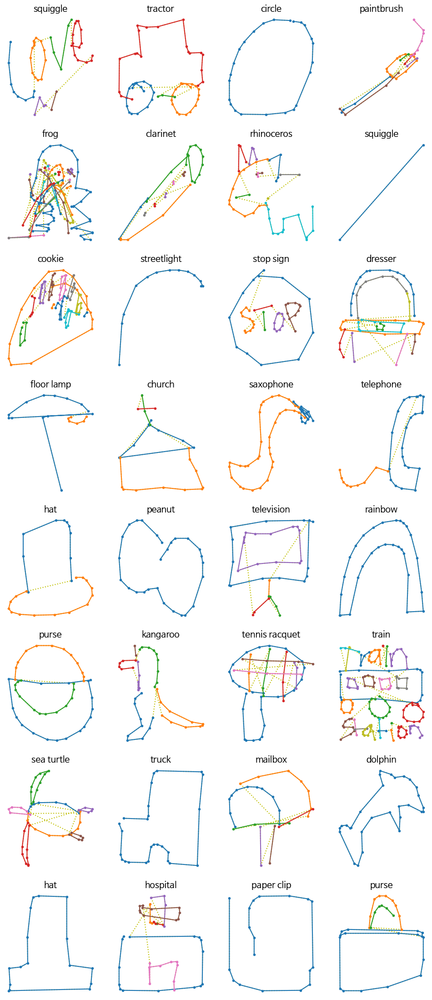

In [104]:
def draw_sketch(sketch, label=None):
    origin = np.array([[0., 0., 0.]])
    sketch = np.r_[origin, sketch]
    stroke_end_indices = np.argwhere(sketch[:, -1]==1.)[:, 0]
    coordinates = sketch[:, :2].cumsum(axis=0)
    strokes = np.split(coordinates, stroke_end_indices + 1)
    title = class_names[label.numpy()] if label is not None else "Try to guess"
    plt.title(title)
    plt.plot(coordinates[:, 0], -coordinates[:, 1], "y:")
    for stroke in strokes:
        plt.plot(stroke[:, 0], -stroke[:, 1], ".-")
    plt.axis("off")

def draw_sketches(sketches, lengths, labels):
    n_sketches = len(sketches)
    n_cols = 4
    n_rows = (n_sketches - 1) // n_cols + 1
    plt.figure(figsize=(n_cols * 3, n_rows * 3.5))
    for index, sketch, length, label in zip(range(n_sketches), sketches, lengths, labels):
        plt.subplot(n_rows, n_cols, index + 1)
        draw_sketch(sketch[:length], label)
    plt.show()

for sketches, lengths, labels in train_set.take(1):
    draw_sketches(sketches, lengths, labels)

대부분의 스케치는 100개 포인트 이하로 구성되어 있습니다:

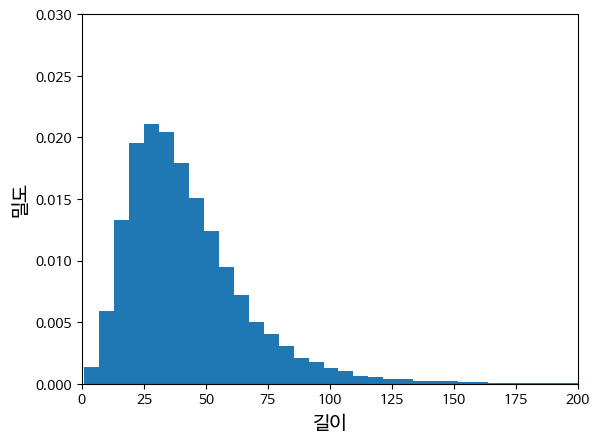

In [105]:
lengths = np.concatenate([lengths for _, lengths, _ in train_set.take(1000)])
plt.hist(lengths, bins=150, density=True)
plt.axis([0, 200, 0, 0.03])
plt.xlabel("길이")
plt.ylabel("밀도")
plt.show()

In [106]:
def crop_long_sketches(dataset, max_length=100):
    return dataset.map(lambda inks, lengths, labels: (inks[:, :max_length], labels))

cropped_train_set = crop_long_sketches(train_set)
cropped_valid_set = crop_long_sketches(valid_set)
cropped_test_set = crop_long_sketches(test_set)

In [107]:
model = tf.keras.Sequential([
    tf.keras.layers.Conv1D(32, kernel_size=5, strides=2, activation="relu"),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Conv1D(64, kernel_size=5, strides=2, activation="relu"),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Conv1D(128, kernel_size=3, strides=2, activation="relu"),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.LSTM(128, return_sequences=True),
    tf.keras.layers.LSTM(128),
    tf.keras.layers.Dense(len(class_names), activation="softmax")
])
optimizer = tf.keras.optimizers.SGD(learning_rate=1e-2, clipnorm=1.)
model.compile(loss="sparse_categorical_crossentropy",
              optimizer=optimizer,
              metrics=["accuracy", "sparse_top_k_categorical_accuracy"])
history = model.fit(cropped_train_set, epochs=2,
                    validation_data=cropped_valid_set)

Epoch 1/2
107813/107813 [==============================] - 1256s 12ms/step - loss: 4.1039 - accuracy: 0.1660 - sparse_top_k_categorical_accuracy: 0.3687 - val_loss: 3.1212 - val_accuracy: 0.3009 - val_sparse_top_k_categorical_accuracy: 0.5852
Epoch 2/2
107813/107813 [==============================] - 1378s 13ms/step - loss: 2.7058 - accuracy: 0.3786 - sparse_top_k_categorical_accuracy: 0.6683 - val_loss: 2.4850 - val_accuracy: 0.4185 - val_sparse_top_k_categorical_accuracy: 0.7089


In [108]:
y_test = np.concatenate([labels for _, _, labels in test_set])
y_probas = model.predict(test_set)

5392/5392 [==============================] - 38s 7ms/step


In [109]:
np.mean(tf.keras.metrics.sparse_top_k_categorical_accuracy(y_test, y_probas))

0.5922169

1/1 [==============================] - 1s 802ms/step


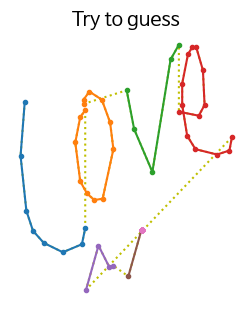

Top-5 predictions:
  1. ant 40.607%
  2. sun 11.712%
  3. spider 9.489%
  4. octopus 6.868%
  5. yoga 2.666%
Answer: squiggle


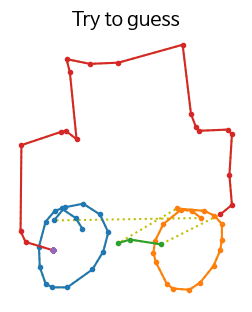

Top-5 predictions:
  1. motorbike 35.588%
  2. tractor 26.347%
  3. bicycle 10.587%
  4. headphones 8.553%
  5. police car 3.099%
Answer: tractor


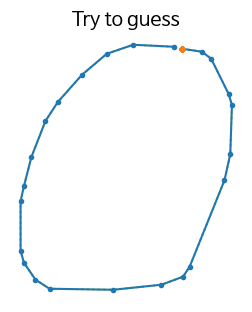

Top-5 predictions:
  1. circle 28.394%
  2. moon 19.492%
  3. necklace 8.456%
  4. potato 6.369%
  5. watermelon 5.055%
Answer: circle


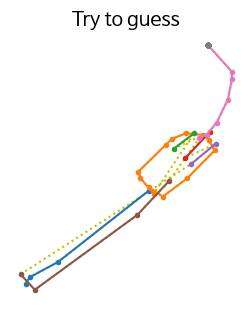

Top-5 predictions:
  1. sun 20.697%
  2. fork 8.712%
  3. yoga 7.875%
  4. ant 4.156%
  5. flamingo 3.681%
Answer: paintbrush


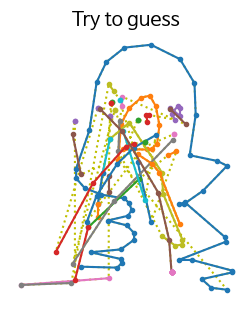

Top-5 predictions:
  1. brain 7.049%
  2. parrot 6.431%
  3. bush 5.948%
  4. squirrel 5.350%
  5. the mona lisa 5.073%
Answer: frog


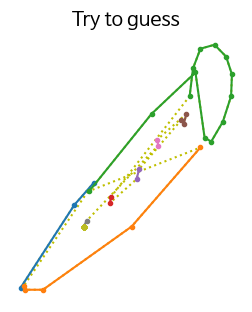

Top-5 predictions:
  1. toothbrush 15.827%
  2. syringe 12.577%
  3. see saw 9.052%
  4. beach 7.530%
  5. matches 4.768%
Answer: clarinet


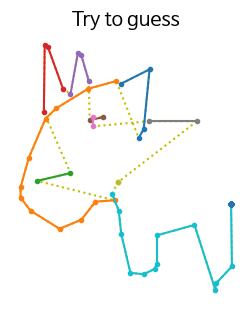

Top-5 predictions:
  1. animal migration 40.802%
  2. rhinoceros 5.577%
  3. beach 5.517%
  4. bird 3.700%
  5. giraffe 3.051%
Answer: rhinoceros


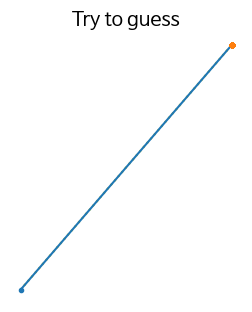

Top-5 predictions:
  1. line 32.370%
  2. ant 3.243%
  3. rain 2.280%
  4. streetlight 1.912%
  5. stairs 1.625%
Answer: squiggle


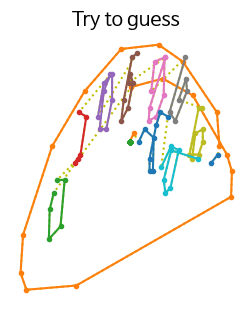

Top-5 predictions:
  1. peas 23.104%
  2. sea turtle 4.855%
  3. train 4.166%
  4. goatee 4.162%
  5. stop sign 4.124%
Answer: cookie


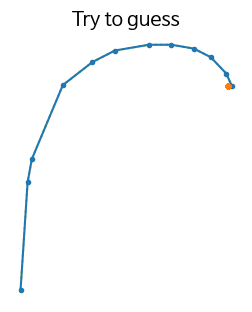

Top-5 predictions:
  1. streetlight 31.239%
  2. headphones 5.092%
  3. line 3.483%
  4. rain 2.260%
  5. lollipop 2.245%
Answer: streetlight


In [110]:
n_new = 10
Y_probas = model.predict(sketches)
top_k = tf.nn.top_k(Y_probas, k=5)
for index in range(n_new):
    plt.figure(figsize=(3, 3.5))
    draw_sketch(sketches[index])
    plt.show()
    print("Top-5 predictions:".format(index + 1))
    for k in range(5):
        class_name = class_names[top_k.indices[index, k]]
        proba = 100 * top_k.values[index, k]
        print("  {}. {} {:.3f}%".format(k + 1, class_name, proba))
    print("Answer: {}".format(class_names[labels[index].numpy()]))

In [111]:
model.save("my_sketchrnn", save_format="tf")

## 10. 바흐 합창곡

_연습문제: [바흐 합창곡](https://homl.info/bach) 데이터셋을 다운로드하여 압축을 풉니다. 이 데이터셋은 요한 제바스티안 바흐가 작곡한 382개의 합창곡으로 구성되어 있습니다. 각 곡은 100에서 640까지 타임 스텝 길이입니다. 각 타임 스텝은 4개의 정수를 담고 있습니다. 각 정수는 피아노 음표의 인덱스에 해당합니다(연주되는 음표가 없다는 것을 의미하는 0은 제외). 코랄의 타임 스텝 시퀀스가 주어지면 다음 타임 스텝(4개의 음표)을 예측할 수 있는 순환 모델, 합성곱 모델 또는 두 가지를 합친 모델을 훈련하세요. 그 다음 이 모델을 사용해 한 번에 하나의 음표씩 바흐와 같은 음악을 생성하세요. 코랄의 시작 부분을 모델에 주입하고 다음 타임 스텝을 예측합니다. 이 타임 스텝을 입력 시퀀스에 추가하여 모델이 다음 음표를 예측하게 만드는 식입니다. 또 바흐를 위한 [구글 두들](https://www.google.com/doodles/celebrating-johann-sebastian-bach)에 사용한 구글의 [Coconet 모델](https://homl.info/coconet)을 확인해보세요._

In [112]:
tf.keras.utils.get_file(
    "jsb_chorales.tgz",
    "https://github.com/ageron/data/raw/main/jsb_chorales.tgz",
    cache_dir=".",
    extract=True)

117793/117793 [==============================] - 0s 0us/step


'./datasets/jsb_chorales.tgz'

In [113]:
jsb_chorales_dir = Path("datasets/jsb_chorales")
train_files = sorted(jsb_chorales_dir.glob("train/chorale_*.csv"))
valid_files = sorted(jsb_chorales_dir.glob("valid/chorale_*.csv"))
test_files = sorted(jsb_chorales_dir.glob("test/chorale_*.csv"))

In [114]:
import pandas as pd

def load_chorales(filepaths):
    return [pd.read_csv(filepath).values.tolist() for filepath in filepaths]

train_chorales = load_chorales(train_files)
valid_chorales = load_chorales(valid_files)
test_chorales = load_chorales(test_files)

In [115]:
train_chorales[0]

[[74, 70, 65, 58],
 [74, 70, 65, 58],
 [74, 70, 65, 58],
 [74, 70, 65, 58],
 [75, 70, 58, 55],
 [75, 70, 58, 55],
 [75, 70, 60, 55],
 [75, 70, 60, 55],
 [77, 69, 62, 50],
 [77, 69, 62, 50],
 [77, 69, 62, 50],
 [77, 69, 62, 50],
 [77, 70, 62, 55],
 [77, 70, 62, 55],
 [77, 69, 62, 55],
 [77, 69, 62, 55],
 [75, 67, 63, 48],
 [75, 67, 63, 48],
 [75, 69, 63, 48],
 [75, 69, 63, 48],
 [74, 70, 65, 46],
 [74, 70, 65, 46],
 [74, 70, 65, 46],
 [74, 70, 65, 46],
 [72, 69, 65, 53],
 [72, 69, 65, 53],
 [72, 69, 65, 53],
 [72, 69, 65, 53],
 [72, 69, 65, 53],
 [72, 69, 65, 53],
 [72, 69, 65, 53],
 [72, 69, 65, 53],
 [74, 70, 65, 46],
 [74, 70, 65, 46],
 [74, 70, 65, 46],
 [74, 70, 65, 46],
 [75, 69, 63, 48],
 [75, 69, 63, 48],
 [75, 67, 63, 48],
 [75, 67, 63, 48],
 [77, 65, 62, 50],
 [77, 65, 62, 50],
 [77, 65, 60, 50],
 [77, 65, 60, 50],
 [74, 67, 58, 55],
 [74, 67, 58, 55],
 [74, 67, 58, 53],
 [74, 67, 58, 53],
 [72, 67, 58, 51],
 [72, 67, 58, 51],
 [72, 67, 58, 51],
 [72, 67, 58, 51],
 [72, 65, 57

음표의 범위는 36(C1 = 옥타브 1의 C)에서 81(A5 = 옥타브 5의 A)까지이고 무음을 위해 0을 추가합니다:

In [116]:
notes = set()
for chorales in (train_chorales, valid_chorales, test_chorales):
    for chorale in chorales:
        for chord in chorale:
            notes |= set(chord)

n_notes = len(notes)
min_note = min(notes - {0})
max_note = max(notes)

assert min_note == 36
assert max_note == 81

이 코랄을 듣기 위한 몇 개의 함수를 만들어 보죠(자세한 내용을 이해할 필요는 없습니다. 사실 MIDI 플레이어처럼 더 간단한 방법이 있지만 그냥 하나의 합성기(synthesizer)를 만들어 보고 싶었습니다):

In [117]:
from IPython.display import Audio

def notes_to_frequencies(notes):
    # 한 옥타브 올라갈 때 주파수는 두배가 됩니다; 옥타브마다 12개의 반음이 있습니다;
    # 옥타브 4의 A는 440Hz이고 음표 번호는 69입니다.
    return 2 ** ((np.array(notes) - 69) / 12) * 440

def frequencies_to_samples(frequencies, tempo, sample_rate):
    note_duration = 60 / tempo # tempo는 분당 박자 수로 측정합니다
    # 매 박자마다 딸깍거리는 소리를 줄이기 위해 주파수를 반올림하여 각 음의 끝에서 샘플을 0에 가깝게 만듭니다.
    frequencies = (note_duration * frequencies).round() / note_duration
    n_samples = int(note_duration * sample_rate)
    time = np.linspace(0, note_duration, n_samples)
    sine_waves = np.sin(2 * np.pi * frequencies.reshape(-1, 1) * time)
    # (음표 0 = 무음을 포함해) 9Hz 이하인 주파수는 모두 삭제합니다
    sine_waves *= (frequencies > 9.).reshape(-1, 1)
    return sine_waves.reshape(-1)

def chords_to_samples(chords, tempo, sample_rate):
    freqs = notes_to_frequencies(chords)
    freqs = np.r_[freqs, freqs[-1:]] # 마지막 음표를 조금 더 길게합니다
    merged = np.mean([frequencies_to_samples(melody, tempo, sample_rate)
                     for melody in freqs.T], axis=0)
    n_fade_out_samples = sample_rate * 60 // tempo # 마지막 음을 희미하게 합니다
    fade_out = np.linspace(1., 0., n_fade_out_samples)**2
    merged[-n_fade_out_samples:] *= fade_out
    return merged

def play_chords(chords, tempo=160, amplitude=0.1, sample_rate=44100, filepath=None):
    samples = amplitude * chords_to_samples(chords, tempo, sample_rate)
    if filepath:
        from scipy.io import wavfile
        samples = (2**15 * samples).astype(np.int16)
        wavfile.write(filepath, sample_rate, samples)
        return display(Audio(filepath))
    else:
        return display(Audio(samples, rate=sample_rate))

이제 몇 개의 코랄을 들어 보죠:

In [118]:
for index in range(3):
    play_chords(train_chorales[index])

멋지네요! :)

새로운 코랄을 생성하기 위해서는 이전의 화음이 주어졌을 때 다음 화음을 예측할 수 있는 모델을 훈련해야 합니다. 한 번에 4개의 음표를 예측하는 식으로 다음 화음을 예측한다면 잘 어울리지 않는 음표를 얻게 됩니다(믿으세요. 제가 해 보았습니다). 한 번에 하나의 음표를 예측하는 것이 간단하고 더 낫습니다. 따라서 모든 코랄을 전처리하여 각 화음을 아르페지오로 바꾸어야 합니다(즉, 동시에 연주되는 음표가 아니라 음표의 시퀀스). 그다음 이전의 모든 음표가 주어졌을 때 다음 음표를 예측하는 모델을 훈련할 수 있습니다. 시퀀스-투-시퀀스 방식을 사용하겠습니다. 신경망에 한 윈도를 주입하고 한 타임 스텝 미래로 이동한 윈도를 예측합니다.

또한 0에서 46까지 범위를 갖도록 값을 이동시키겠습니다. 여기에서 0은 무음을 나타내고 1에서 46까지는 36(C1)에서 81(A5)까지를 나타냅니다.

128 음표(즉, 32개 화음)의 윈도에서 모델을 훈련하겠습니다.

이 데이터셋은 메모리에 올라갈 수 있기 때문에 파이썬 코드를 사용해 RAM에서 코랄을 전처리할 수 있지만 여기에서는 tf.data를 사용해 전처리하는 방법을 시연하겠습니다(다음 장에서 tf.data를 사용해 윈도를 만드는 과정을 자세히 설명하겠습니다).

In [119]:
def create_target(batch):
    X = batch[:, :-1]
    Y = batch[:, 1:] # 각 스텝에서 아르페지오에 있는 다음 음표를 예측합니다
    return X, Y

def preprocess(window):
    window = tf.where(window == 0, window, window - min_note + 1) # 값 이동
    return tf.reshape(window, [-1]) # 아르페지오로 변환

def bach_dataset(chorales, batch_size=32, shuffle_buffer_size=None,
                 window_size=32, window_shift=16, cache=True):
    def batch_window(window):
        return window.batch(window_size + 1)

    def to_windows(chorale):
        dataset = tf.data.Dataset.from_tensor_slices(chorale)
        dataset = dataset.window(window_size + 1, window_shift, drop_remainder=True)
        return dataset.flat_map(batch_window)

    chorales = tf.ragged.constant(chorales, ragged_rank=1)
    dataset = tf.data.Dataset.from_tensor_slices(chorales)
    dataset = dataset.flat_map(to_windows).map(preprocess)
    if cache:
        dataset = dataset.cache()
    if shuffle_buffer_size:
        dataset = dataset.shuffle(shuffle_buffer_size)
    dataset = dataset.batch(batch_size)
    dataset = dataset.map(create_target)
    return dataset.prefetch(1)

훈련 세트, 검증 세트, 테스트 세트를 만듭니다:

In [120]:
train_set = bach_dataset(train_chorales, shuffle_buffer_size=1000)
valid_set = bach_dataset(valid_chorales)
test_set = bach_dataset(test_chorales)

이제 모델을 만듭니다:

* 음표를 실수 값으로 모델에 직접 주입할 수 있지만 좋은 결과를 얻지 못할 것입니다. 음표 간의 관계는 단순하지 않습니다. 예를 들어 C3을 C4로 바꾼다면 두 음표 사이에 반음이 12개(즉 한 옥타브) 떨어져 있음에도 멜로디는 여전히 괜찮게 들립니다. 반대로 C3을 C\#3으로 바꾼다면 바로 다음 음표임에도 화음이 매우 좋지 않습니다. 따라서 `Embedding` 층을 사용해 음표를 작은 벡터 표현으로 바꾸겠습니다(임베딩에 대해서는 16장을 참고하세요). 5-차원 임베딩을 사용하므로 첫 번째 층의 출력은 `[batch_size, window_size, 5]` 크기가 됩니다.
* 그 다음 이 데이터를 4개의 `Conv1D` 층을 쌓고 dilation 비율을 두 배씩 늘린 작은 WeveNet 신경망에 주입합니다. 빠른 수렴을 위해 이 층 다음에 `BatchNormalization` 층을 배치합니다.
* 그다음 하나의 `LSTM` 층이 장기 패턴을 감지합니다.
* 마지막으로 `Dense` 층이 최종 음표 확률을 생성합니다. 타임 스텝과 (무음을 포함해) 가능한 음표 마다 배치에 있는 각 코랄에 대해 하나의 확률을 예측합니다. 따라서 출력 크기는 `[batch_size, window_size, 47]`가 됩니다.

In [121]:
n_embedding_dims = 5

model = tf.keras.Sequential([
    tf.keras.layers.Embedding(input_dim=n_notes, output_dim=n_embedding_dims,
                           input_shape=[None]),
    tf.keras.layers.Conv1D(32, kernel_size=2, padding="causal", activation="relu"),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Conv1D(48, kernel_size=2, padding="causal", activation="relu", dilation_rate=2),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Conv1D(64, kernel_size=2, padding="causal", activation="relu", dilation_rate=4),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Conv1D(96, kernel_size=2, padding="causal", activation="relu", dilation_rate=8),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.LSTM(256, return_sequences=True),
    tf.keras.layers.Dense(n_notes, activation="softmax")
])

model.summary()

Model: "sequential_15"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (None, None, 5)           235       
                                                                 
 conv1d_22 (Conv1D)          (None, None, 32)          352       
                                                                 
 batch_normalization_3 (Bat  (None, None, 32)          128       
 chNormalization)                                                
                                                                 
 conv1d_23 (Conv1D)          (None, None, 48)          3120      
                                                                 
 batch_normalization_4 (Bat  (None, None, 48)          192       
 chNormalization)                                                
                                                                 
 conv1d_24 (Conv1D)          (None, None, 64)        

이제 모델을 컴파일하고 훈련할 준비가 되었습니다!

In [122]:
optimizer = tf.keras.optimizers.Nadam(learning_rate=1e-3)
model.compile(loss="sparse_categorical_crossentropy", optimizer=optimizer,
              metrics=["accuracy"])
model.fit(train_set, epochs=20, validation_data=valid_set)

Epoch 1/20
98/98 [==============================] - 16s 55ms/step - loss: 1.9279 - accuracy: 0.5078 - val_loss: 3.6846 - val_accuracy: 0.1197
Epoch 2/20
98/98 [==============================] - 3s 31ms/step - loss: 0.9025 - accuracy: 0.7616 - val_loss: 3.6811 - val_accuracy: 0.1049
Epoch 3/20
98/98 [==============================] - 2s 24ms/step - loss: 0.7497 - accuracy: 0.7916 - val_loss: 3.4033 - val_accuracy: 0.1559
Epoch 4/20
98/98 [==============================] - 2s 24ms/step - loss: 0.6711 - accuracy: 0.8079 - val_loss: 2.5268 - val_accuracy: 0.2975
Epoch 5/20
98/98 [==============================] - 3s 28ms/step - loss: 0.6202 - accuracy: 0.8192 - val_loss: 1.6487 - val_accuracy: 0.5126
Epoch 6/20
98/98 [==============================] - 2s 24ms/step - loss: 0.5794 - accuracy: 0.8285 - val_loss: 1.0331 - val_accuracy: 0.7007
Epoch 7/20
98/98 [==============================] - 2s 21ms/step - loss: 0.5442 - accuracy: 0.8370 - val_loss: 0.7055 - val_accuracy: 0.7959
Epoch 8/20
9

여기서는 하이퍼파라미터 탐색을 많이 수행하지 않았습니다. 자유롭게 이 모델을 사용해 하이퍼파라미터를 탐색하고 최적화해 보세요. 예를 들어 `LSTM` 층을 제거하고 `Conv1D` 층으로 바꿀 수 있습니다. 층의 개수, 학습률, 옵티마이저 등을 실험해 볼 수 있습니다.

검증 세트에 대한 모델의 성능이 만족스럽다면 모델을 저장하고 테스트 세트에서 마지막으로 평가합니다:

In [123]:
model.save("my_bach_model", save_format="tf")
model.evaluate(test_set)

34/34 [==============================] - 1s 16ms/step - loss: 0.6290 - accuracy: 0.8205


[0.6290357112884521, 0.8205426931381226]

**노트:** 이 예제에서는 테스트 세트가 진짜로 필요하지 않습니다. 모델이 생성한 음악을 듣는 것이 최종 평가가 되기 때문입니다. 따라서 필요하다면 테스트 세트를 훈련 세트에 넣고 모델을 다시 훈련하여 조금 더 나은 모델을 얻을 수 있습니다.

이제 새로운 코랄을 생성하는 함수를 만들어 보죠. 몇 개의 시드 화음을 주고 이를 (모델이 기대하는 포맷인) 아르페지오로 변환합니다. 그다음 모델을 사용해 다음 음표을 예측합니다. 마지막에 4개씩 음표를 모아서 다시 화음을 만들고 최종 코랄을 반환합니다.

In [124]:
def generate_chorale(model, seed_chords, length):
    arpegio = preprocess(tf.constant(seed_chords, dtype=tf.int64))
    arpegio = tf.reshape(arpegio, [1, -1])
    for chord in range(length):
        for note in range(4):
            next_note = model.predict(arpegio, verbose=0).argmax(axis=-1)[:1, -1:]
            arpegio = tf.concat([arpegio, next_note], axis=1)
    arpegio = tf.where(arpegio == 0, arpegio, arpegio + min_note - 1)
    return tf.reshape(arpegio, shape=[-1, 4])

이 함수를 테스트하려면 시드 화음이 필요합니다. 테스트 코랄 중 하나에 있는 처음 8개의 화음을 사용해 보죠(실제로 이는 4번 반복되는 2개의 화음입니다):

In [125]:
seed_chords = test_chorales[2][:8]
play_chords(seed_chords, amplitude=0.2)

첫 번째 코랄을 생성할 준비를 마쳤습니다! 56개의 화음을 생성하여 총 64개의 화음, 즉 4 소절(소절마다 4개의 화음인 4/4박으로 가정합니다)을 만들어 보겠습니다:

In [126]:
new_chorale = generate_chorale(model, seed_chords, 56)
play_chords(new_chorale)

이 방식에는 한가지 단점이 있습니다: 너무 보수적인 경우가 많습니다. 실제로 이 모델은 모험을 하지 않아 항상 가장 높은 확률의 음표를 선택합니다. 이전 음표를 반복하면 충분히 듣기 좋고 가장 덜 위험하기 때문에 이 알고리즘은 마지막 음표를 오래 지속시키는 경향이 있습니다. 상당히 지루합니다. 또한 이 모델을 여러 번 실행하면 항상 같은 멜로디를 생성할 것입니다.

조금 더 신나게 만들어 보죠! 항상 가장 높은 점수의 음표를 선택하는 대신, 예측된 확률을 기반으로 랜덤하게 다음 음표를 선택하겠습니다. 예를 들어, 모델이 75% 확률로 C3를 예측하고 25% 확률로 G3를 예측했다면 이 확률대로 랜덤하게 두 음표 중 하나를 선택하겠습니다. 또한 `temperature` 매개변수를 추가하여 시스템의 온도(즉 대담성)를 제어하겠습니다. 높은 온도는 예측 확률을 비슷하게 만들어 가능성이 높은 음표의 확률을 줄이고 가능성이 낮은 음표의 확률을 높입니다.

In [127]:
def generate_chorale_v2(model, seed_chords, length, temperature=1):
    arpegio = preprocess(tf.constant(seed_chords, dtype=tf.int64))
    arpegio = tf.reshape(arpegio, [1, -1])
    for chord in range(length):
        for note in range(4):
            next_note_probas = model.predict(arpegio)[0, -1:]
            rescaled_logits = tf.math.log(next_note_probas) / temperature
            next_note = tf.random.categorical(rescaled_logits, num_samples=1)
            arpegio = tf.concat([arpegio, next_note], axis=1)
    arpegio = tf.where(arpegio == 0, arpegio, arpegio + min_note - 1)
    return tf.reshape(arpegio, shape=[-1, 4])

이 함수로 3개의 코랄을 생성해 보겠습니다. 하나는 차갑게, 하나는 중간으로, 하나는 뜨겁게 만듭니다(시드, 길이, 온도를 사용해 자유롭게 실험해 보세요). 다음 코드는 각 코랄을 별개의 파일에 저장합니다. 마음에 드는 음악을 만날 때까지 이 셀을 반복해서 실행할 수 있습니다!

**가장 아름다운 코랄을 트위터 @aureliengeron로 공유해 주시면 정말 감사하겠습니다! :))**

In [128]:
new_chorale_v2_cold = generate_chorale_v2(model, seed_chords, 56, temperature=0.8)
play_chords(new_chorale_v2_cold, filepath="bach_cold.wav")

1/1 [==============================] - 0s 33ms/step


In [129]:
new_chorale_v2_medium = generate_chorale_v2(model, seed_chords, 56, temperature=1.0)
play_chords(new_chorale_v2_medium, filepath="bach_medium.wav")

1/1 [==============================] - 0s 24ms/step


In [130]:
new_chorale_v2_hot = generate_chorale_v2(model, seed_chords, 56, temperature=1.5)
play_chords(new_chorale_v2_hot, filepath="bach_hot.wav")

1/1 [==============================] - 0s 34ms/step


마지막으로 재미있는 실험을 해 볼 수 있습니다: 친구에게 마음에 드는 코랄 몇 개와 진짜 코랄을 보내고 어떤 것이 진짜인지 물어 보세요!

In [131]:
play_chords(test_chorales[2][:64], filepath="bach_test_4.wav")